In [4]:
using QuantumToolbox
using SparseArrays
using PlotlyJS
using Arpack

# using Pkg
# Pkg.add("ArnoldiMethod")

In [40]:
# # can't be autoreloaded
# include("basic_codes.jl")
# using .basic_codes

# Cat qubits

## Introduction
A cat qubit is usually thought of as arising from either two-photon driven-dissipation
$$ \mathcal{L}\rho = \kappa_2 \mathcal{D}[a^2 - \alpha^2]\rho $$
or a strong non-linearity from the Hamiltonian
$$ \mathcal{L}\rho = -i[\Delta a^{\dagger}a + Ua^{\dagger}a^{\dagger}a a, \rho]. $$
Both will stabilize a steady state manifold spanned by $\{|\alpha\rangle,|-\alpha\rangle\} = \{|0\rangle,|1\rangle\}$, the coherent states of the QHO. In particular, the states
$$ | {\pm}_{\alpha} \rangle = \frac{|0\rangle \pm |1\rangle}{\sqrt{2}} $$
are the so-called **cat qubit states** and are exactly orthogonal, given that they are superpositions of only even or odd number states.

## Critical cat
The critical cat qubit accounts for both the dissipative and Hamiltonian schemes (they are the respective limits of the model), exploring more of the parameter space in the hopes of finding regimes where a stable (or perhaps metastable, long-lived, fault-tolerant, high gate fidelity, etc) encoding of the cat qubit is possible. In the following we go through the critical cat's different regimes and illustrate its usefulness over traditional only-dissipative or only-kerr qubits.

### Note on the symmetries of the cat qubit
There are two types of symmetries: strong and weak. The former is when the symmetry operator, in this case the parity $\Pi = (-1)^{a^{\dagger }a}$, commutes with the Hamiltonian and all jump operators. The latter is when the superoperator $S(\bullet) = \Pi \bullet \Pi^{\dagger}$ commutes with the Liouvillian. In the world of superoperators, a commutation is understood to be
$$ \Pi \left(\mathcal{L} \rho \right) \Pi^{\dagger} = \mathcal{L} \left(\Pi \rho \Pi^{\dagger} \right)$$
for an arbitrary operator $\rho$. 

Assuming for the moment that the symmetry is a $2$-fold $\mathbb{Z}_2$ symmetry (as is the case here), then a weak symmetry will block diagonalize $\mathcal{L}$ into two blocks of corresponding to "superparity" eigenvalues $p_{\pm} = \pm 1$. This number can be thought of as the difference in parity of the ket and bra spaces $|n\rangle\langle m|$ -- if $n$ and $m$ have the same parity, then they are in $p_+$, and vice-versa.

In the strong-symmetric case, we can introduce the left- and right-parity superoperators $\Pi_L(\bullet) = \Pi \bullet$ and $\Pi_R(\bullet) = \bullet \Pi^{\dagger}$. These operators clearly commute with each other and, since $\Pi$ commutes with every jump operator plus the Hamiltonian (which is also a jump operator of some sort -- see the derivation of the Lindblad master equation). Therefore, $\mathcal{L}$ can be decomposed into $n^2 = 4$ blocks $\mathcal{L} = \mathcal{L}_{++} \oplus \mathcal{L}_{--} \oplus \mathcal{L}_{+-} \oplus \mathcal{L}_{-+}$. Note that $\mathcal{L}_{++}$ and $\mathcal{L}_{--}$ belong to the weak-symmetric's $p_+$ space, while the other two belong to $p_-$. the strong symmetry therefore simply further resolves the underlying subspaces by differentiating left- and right-eigenoperators.

In [1]:
function get_liouvillian(N::Int, Δ::Real, G::Real, tg::Real, κ1::Real, κϕ::Real)
    """
    Constructs the Liouvillian superoperator from a Hamiltonian and a set of collapse operators.
    
    Parameters:
    H (Operator): The Hamiltonian of the system.
    c_ops (Vector{Operator}): A vector of collapse operators.
    
    Returns:
    Liouvillian: The Liouvillian superoperator.
    """
    # define operators
    a = destroy(N)
    ad = create(N)

    # adjust Parameters
    U = tg/sqrt(1+tg^2)
    k2 = 1/sqrt(1+tg^2)
   
    # Construct the Hamiltonian
    H = Δ*ad*a + G/2*(ad^2+a^2) - U/2*(ad^2*a^2)

    # collapse operators
    c_ops = [sqrt(k2)*a^2, sqrt(κ1)*a, sqrt(κϕ)*ad*a]
    
    # Construct the Liouvillian
    L = liouvillian(H, c_ops)

    return L, a, ad
end;

# function to plot the wigner function
function plot_wigner(rho,xx,yy)
    layout = Layout(
        xaxis_title="Re(β)",
        yaxis_title="Im(β)",
        title="Wigner function",
        width=500,
        height=500
    )
    
    w = wigner(rho, xx, yy);
    vbound = maximum(abs.(w))

    custom_colorscale = [
        [0, "blue"],   # Negative values to blue
        [0.5, "white"],  # Zero values to white
        [1, "red"],     # Positive values to red
    ]

    heatmap_trace = heatmap(
        z=w,
        x=xx,
        y=yy,
        colorscale=custom_colorscale,
        showscale=true,
        zmin = -vbound,
        zmax = vbound
    )

    plot(heatmap_trace, layout)
end;

# fix the size of the vector which has support only in one block 
function completevec(vec, nblock, P, block_indices, block_sizes; unvectorize=true, retQobj=true, tosparse=true)
    # make a (possibly sparse) vector the correct size of the full system
    v = tosparse ? sparse(zeros(ComplexF64,(sum(block_sizes),1))) : zeros(ComplexF64,(sum(block_sizes),1))

    # put the vector in the correct block (the rest is zero)
    v[block_indices[nblock]:block_indices[nblock]+block_sizes[nblock]-1] = vec

    # apply the conjugate permutation to revert into original basis
    v = P'*v

    # depending on vectorization/qobj, return the correct vector
    if retQobj
        v = unvectorize ? QuantumObject(reshape(v, (N,N))) : QuantumObject(v)
    else
        v = unvectorize ? reshape(v, (N,N)) : v
    end
    return v
end

# get the lowest lying states and values from the different symmetry sectors
function get_lowlying(N::Int, G::Real, Δ::Real, tg::Real, κ1::Real, κϕ::Real, nev::Int, sigma::Real; nvecs=2, left=false, maxiter=300)
    # Get the Liouvillian
    L, a, ad  = get_liouvillian(N, Δ, G, tg, κ1, κϕ)
    # Get the block diagonal form of the Liouvillian with bdf function 
    # Get the block diagonal form of the Liouvillian with bdf function
    if left
        P, Lbd, block_sizes = bdf(Qobj(L'))
    else
        P, Lbd, block_sizes = bdf(L)
    end

    block_list, block_indices = get_bdf_blocks(Lbd,block_sizes)

    # set up the lists for the eigenvalues and eigenvectors
    ρl = []
    Λl = Vector{ComplexF64}[]

    # adjust the number of eigenvalues to be calculated
    nev = maximum([nev, nvecs])

    # loop over all blocks (either 2 or 4 depending on k1)
    for nblock in 1:length(block_list)
        evals, evecs = eigs(block_list[nblock],  nev=nev, sigma=sigma, maxiter=maxiter) # diagonalize sparse matrix
        # result = eigsolve(block_list[nblock], k=nev, sigma=sigma, maxiter=maxiter) ### eigsolve method for threads
        # evals, evecs = result.values, result.vectors ### eigsolve method for threads
        args         = sortperm(abs.(real.(evals))) # permuation of sorted eigenvalues
        evals, evecs = evals[args], evecs[:,args]

        Λ = evals[1:nvecs]
        ρ = collect(eachcol(evecs[:,1:nvecs])) # take only first nvecs eigenvectors and change to array

        ρ = map(x->completevec(x, nblock, P, block_indices, block_sizes; unvectorize=true), ρ) # make the vectors the correct size and unvectorize them
        ρ = map(x-> abs(tr(x))>0.1 ? x/tr(x)  : x/x.data[x.data.!=0][1], ρ) # normalize the vectors (density matrices)
        ρ = map(x-> abs(tr(x))>0.1 ? (x+x')/2 : x+x' , ρ)

        # append the values to the return lists
        push!(ρl,ρ)
        push!(Λl,Λ)
    end
    return Λl, ρl
end # get_lowlying

# spectral decomposition function
function spectral_decomposition(ρ)
    # warning if trace is not 0
    matrix_trace = tr(ρ)
    if abs(matrix_trace)>1e-10
        print("Warning: trace of input matrix $matrix_trace is not zero", )
    end
    # spectral decomposition
    ri,ψi = eigen(ρ)
    
    # separate positive and negative eigenvalues (guaranteed to be real if ρ is hermitian)
    cp = real(ri).>0
    cm = real(ri).<0

    # arrays of positive and negative eigenvalues and eigenvectors
    ep = ri[cp]
    em = ri[cm]
    vp = ψi[cp]
    vm = ψi[cm]
    
    # initialize density matrices
    ρp = ep[1]*ket2dm(QuantumObject(vp[1]))
    ρm = em[1]*ket2dm(QuantumObject(vm[1]))
    
    # loop over positive space projectors
    for i in 2:length(ep)
        p = ep[i]
        v = vp[i]
        ρp += p*ket2dm(QuantumObject(v))
    end
    
    # loop over negative space projectors
    for i in 2:length(em)
        p = em[i]
        v = vm[i]
        ρm += -p*ket2dm(QuantumObject(v))
    end
    
    # normalize
    ρm = ρm/tr(ρm)
    ρp = ρp/tr(ρp)

    return ρp, ρm
end;

function spectral_decomposition_bis(rho) # seems to work better than the previous one
    # simple spectral decomposition
    es, sts = eigen(rho)

    iplus = findall(x->real(x)>0, es)
    iminus = findall(x->real(x)<0, es)

    rho_p = sum(es[i] * sts[:][i] * sts[:][i]' for i in iplus)
    rho_m = sum(-es[i] * sts[:][i] * sts[:][i]' for i in iminus)

    rho_p /= tr(rho_p)
    rho_m /= tr(rho_m)

    return rho_p, rho_m
end;

# Initial tests

In [22]:
N = 40
Delta = 0.
G = 5.
tg = 1e2*0
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

L, a, ad = get_liouvillian(N, Delta, G, tg, k1, kphi);

In [23]:
# get the eigenvalues of the Liouvillian
spectrum, states = eigenstates(L);

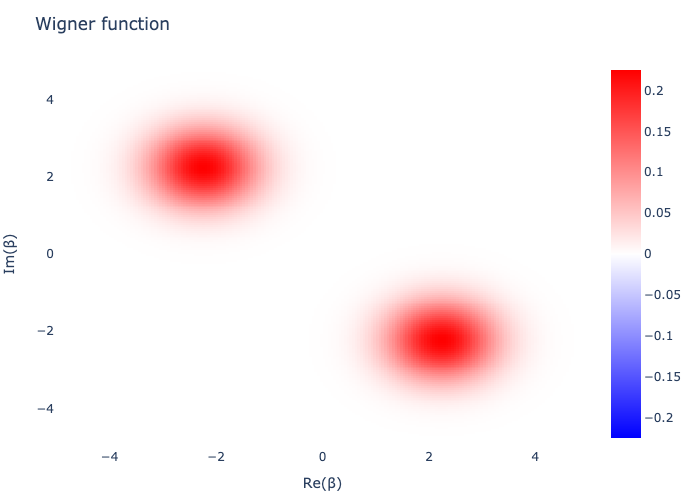

In [14]:
xvec = range(-5, 5, length=200)
plot_wigner(vec2mat(states[end]), xvec, xvec)

# Encoding states

## $\Delta = 0$

In [24]:
# set parameters
N = 90
Δ0 = 0.
G = 5.
tg = 1e5 # not sure about this one
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7;

In [25]:
rates, states = get_lowlying(N, G, Δ0, tg, k1, kphi, nev, sigma);
ρ0p = states[1][1]
ρ1p = states[1][2]
ρ0m = states[2][1]
ρ1m = states[2][2];

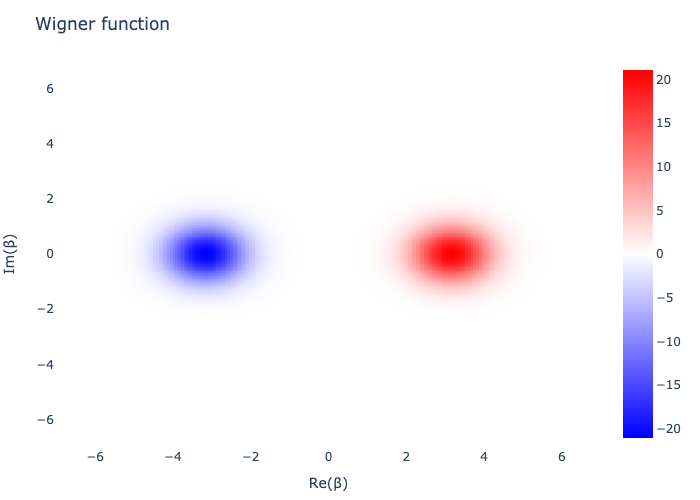

In [26]:
xvec = range(-7, 7, length=200)
plot_wigner(ρ0m, xvec, xvec)

Lowest lying off-diagonal can be decomposed into computational basis. Since the steady state is an even superposition of the two code states, it is the center of the bloch sphere, i.e. the identity in code space (zero expectation value in all "directions").

In [9]:
ρ0mp, ρ0mm = spectral_decomposition_bis(ρ0m);

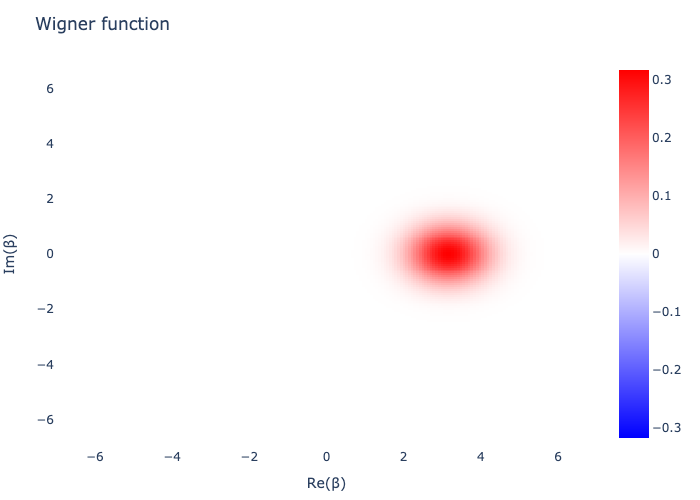

In [10]:
plot_wigner(ρ0mp, xvec, xvec)

## $\Delta > 0$

In [11]:
# set parameters
Δb = 5;

In [12]:
rates, states = get_lowlying(N, G, Δb, tg, k1, kphi, nev, sigma);
ρ0p_b = states[1][1]
ρ1p_b = states[1][2]
ρ0m_b = states[2][1]
ρ1m_b = states[2][2];

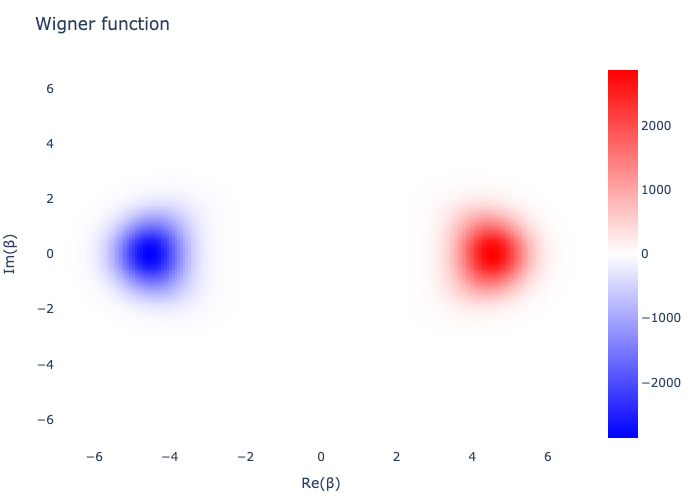

In [13]:
plot_wigner(ρ0m_b, xvec, xvec)

In [24]:
ρ0mp_b, ρ0mm_b = spectral_decomposition_bis(ρ0m_b);

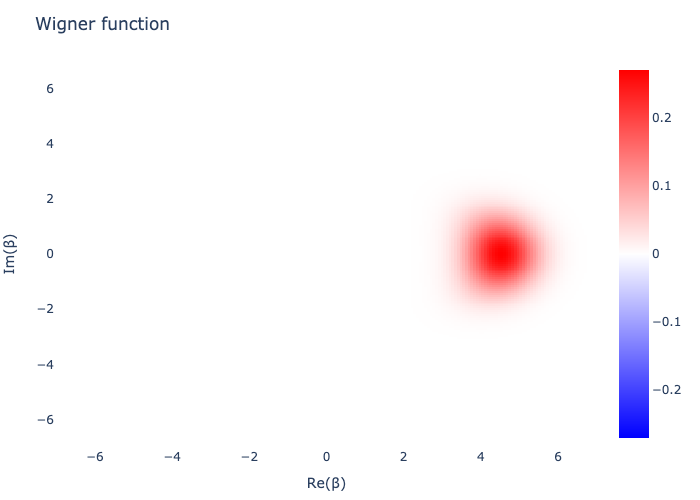

In [25]:
plot_wigner(ρ0mp_b, xvec, xvec)

## $\Delta > \Delta_c$

In [26]:
# set parameters
Δc = 25;

In [27]:
rates, states = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma);
ρ0p_c = states[1][1]
ρ1p_c = states[1][2]
ρ0m_c = states[2][1]
ρ1m_c = states[2][2];

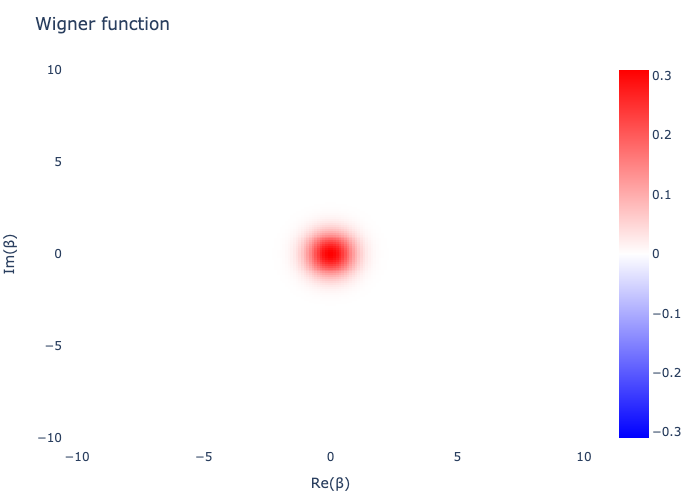

In [28]:
plot_wigner(ρ0p_c, xvec.*1.5, xvec.*1.5) # steady state is now a squeezed vacuum state

Steady state is now a squeezed vacuum state. It cannot serve as the centre of the Bloch sphere and define the desired logical basis. This is  *a priori* problematic because it means that our code states, which previously had theoretically finite lifetime due to being encoded in the steady state, will now only be metastable with lifetime $\Lambda^{-1}$ where $\Lambda$ is the rate of whichever state we define to be the Bloch sphere centre. 

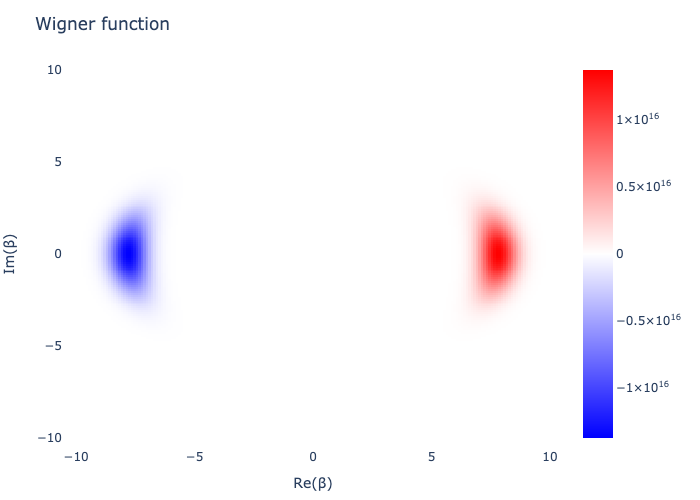

In [29]:
plot_wigner(ρ0m_c, xvec.*1.5, xvec.*1.5)

$\rho_0^-$ is unchanged. Its spectral decomposition components are still the logical basis. 

Look for the new Bloch sphere centre in excited diagonal states.

In [30]:
# new center of bloch sphere is in the first excited state
ρ1pp_c, ρ1pm_c = spectral_decomposition_bis(ρ1p_c);

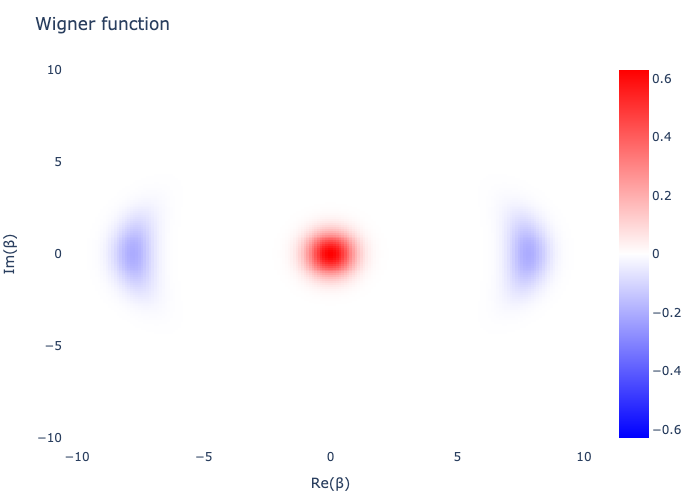

In [31]:
plot_wigner(ρ1p_c, xvec.*1.5, xvec.*1.5) # made up of steady state and bloch sphere center

$\rho_1^+$ is made up of the vacuum state (which we know to be the steady state) and the identity. We can decompose it to find the Bloch sphere centre.

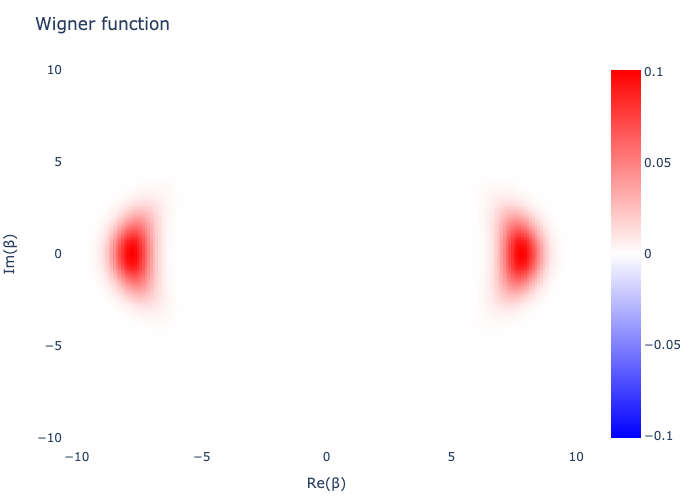

In [32]:
plot_wigner(ρ1pm_c, xvec.*1.5, xvec.*1.5)

This looks a lot like the identity we previously had in other regimes of $\Delta$. Difference being, of course, that states initialized on the bloch sphere will decay towards the steady state at a rate $\Gamma_{\mathrm{leak}} = \Lambda_1^+$. 

# Spectral weights $\langle \sigma | \rho \rangle$

In [27]:
N = 50
Δ = 5.
Δc = 25.
G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

# make the Liouvillian
L, a, ad = get_liouvillian(N, Δ, G, tg, k1, kphi);

In [28]:
# get left eigenvectors of Liouvillian

# block diagonalize the Liouvillian
P, Lbd, block_sizes = bdf(L)
block_list, block_indices = get_bdf_blocks(Lbd,block_sizes);

# make lists to store the eigenvectors and eigenvalues
λll, vll = [], []

# loop over blocks
for i in 1:length(block_list)
    # get the right eigenvectors and eigenvalues
    λl, vr = eigen(Matrix(block_list[i]), sortby = x -> -real(x)) # note the hermitian

    # convert into left eigenvectors
    vl = inv(vr)'

    # completevec on each column to get the correct size
    f = vv -> completevec(vv, i, P, block_indices, block_sizes, unvectorize=false, retQobj=false, tosparse=false)
    push!(vll, mapreduce(f, hcat, eachcol(vl)))
    push!(λll, λl)
end

In [29]:
# put them all into one matrix
vll = hcat(vll...)
λll = hcat(λll...) # still has two dimensions instead of just list


args = sortperm(abs.(real(vec(λll))))
vll = vll[:,args]
λll = λll[args];


In [30]:
# array of left eigenvectors
λl, vl = λll[1:end], vll[:,1:end];

In [31]:
# get the right eigenoperator of interest
rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
ρ0m_c = ρs[2][1]

ρ0mp_c, ρ0mm_c = spectral_decomposition_bis(ρ0m_c);
v = vec(ρ0mm_c.data)
O = abs.(map(s->abs(s'*v/(norm(s')*norm(v))), eachcol(vll)));

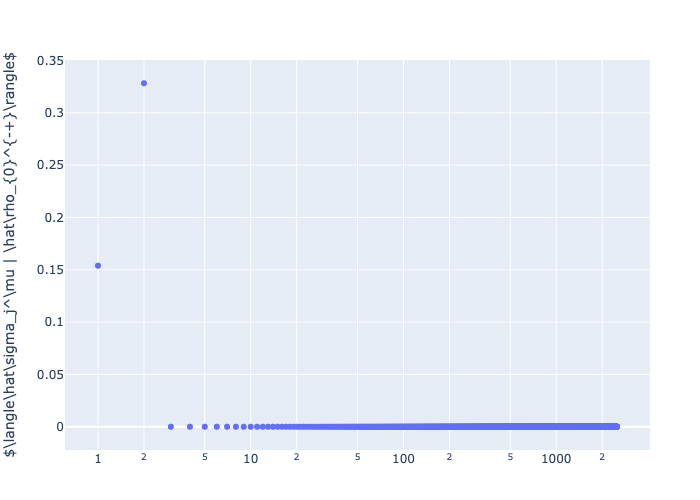

In [32]:
scatter_plot = scatter(x=collect(1:length(O)),y=O, mode="markers")

layout = Layout(
    yaxis_title=raw"$\langle\hat\sigma_j^\mu | \hat\rho_{0}^{-+}\rangle$",
    xaxis_type="log"
)

plot(scatter_plot, layout)

There are only two nonvanishing overlaps at $\Delta < \Delta_c$. When $\Delta$ is larger, however:

In [208]:
# make the liouvillian
L, a, ad = get_liouvillian(N, Δc, G, tg, k1, kphi);

In [ ]:
# get left eigenvectors of Liouvillian

# block diagonalize the Liouvillian
P, Lbd, block_sizes = bdf(L)
block_list, block_indices = get_bdf_blocks(Lbd,block_sizes);

# make lists to store the eigenvectors and eigenvalues
λll, vll = [], []

# loop over blocks
for i in 1:length(block_list)
    # get the right eigenvectors and eigenvalues
    λl, vr = eigen(Matrix(block_list[i]), sortby = x -> -real(x))

    # convert into left eigenvectors
    vl = inv(vr)'

    # completevec on each column to get the correct size
    f = vv -> completevec(vv, i, P, block_indices, block_sizes, unvectorize=false, retQobj=false, tosparse=false)
    push!(vll, mapreduce(f, hcat, eachcol(vl)))
    push!(λll, λl)
end

# put them all into one matrix
vll = hcat(vll...)
λll = hcat(λll...) # still has two dimensions instead of just list


args = sortperm(abs.(real(vec(λll))))
vll = vll[:,args]
λll = λll[args];

# array of left eigenvectors
λl, vl = λll[1:end], vll[:,1:end];

In [210]:
# get the right eigenoperator of interest
rates, ρs = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma)
ρ0m_c = ρs[2][1]

ρ0mp_c, ρ0mm_c = spectral_decomposition_bis(ρ0m_c);
v = vec(ρ0mm_c.data)
O = abs.(map(s->abs(s'*v/(norm(s')*norm(v))), eachcol(vll)));

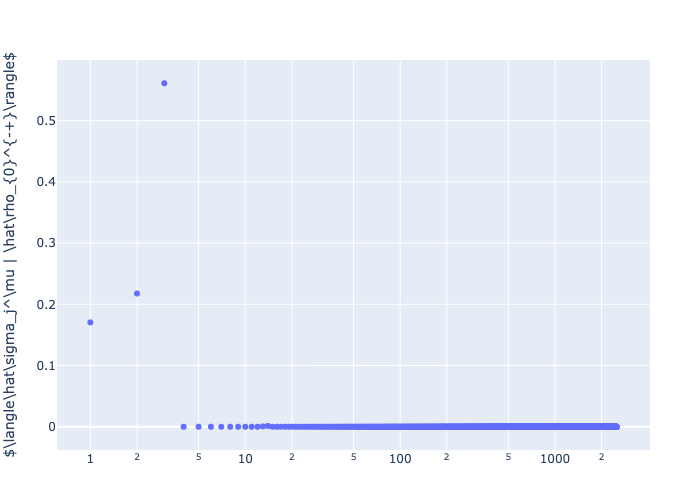

In [211]:
scatter_plot = scatter(x=collect(1:length(O)),y=O, mode="markers")

layout = Layout(
    yaxis_title=raw"$\langle\hat\sigma_j^\mu | \hat\rho_{0}^{-+}\rangle$",
    xaxis_type="log"
)

plot(scatter_plot, layout)

Now there are three nonvanishing overlaps due to the leakage $\Gamma_{\mathrm{leak}}$ from the current center of the bloch sphere $\rho_1 (+)$ towards the steady state $\rho_{ss} = |n=0><n=0|$, outside of the code space. 

# Order parameter 

How does $\langle a^{\dagger}a\rangle$ change as a function of $\Delta$?

In [129]:
# expectation values
N = 90 # only go to high N if using sparse matrices
nev = 30
sigma = 1e-7

G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

res = 200
Deltas = range(0,30,length=res)
expval, expval_p, expval_m = [], [], []

for i in 1:res
    # set Delta
    Δ = Deltas[i]
    # get liouvillian
    L, a, ad = get_liouvillian(N, Δ, tg, k1, kphi)
    # get the states of interest
    rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
    # get the steady state
    ρss = ρs[1][1]
    # get the rho_1_+ density matrices
    ρ1p = ρs[1][2]
    # decompose it
    ρ1p_p, ρ1p_m = spectral_decomposition_bis(ρ1p)
    # compute expectation values of the number operator
    push!(expval, real(expect(ad*a,ρss)))
    push!(expval_m, real(expect(ad*a,ρ1p_m)))
    push!(expval_p, real(expect(ad*a,ρ1p_p)))
end

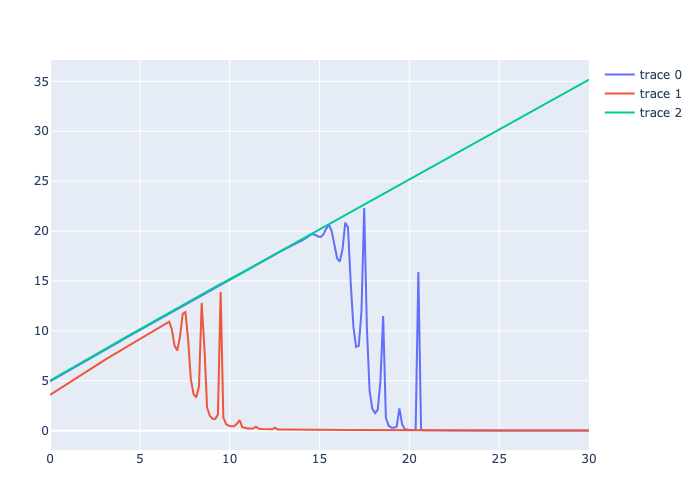

In [130]:
op_plot = scatter(x=Deltas,y=expval)
op_plot_p = scatter(x=Deltas,y=expval_p)
op_plot_m = scatter(x=Deltas,y=expval_m)

# make appropriate layout
layout = Layout(
    yaxis_title="<a^{dagger}a>",
    xaxis_title="Δ",
    width=500,
    height=500
)

plot([op_plot,op_plot_p, op_plot_m])

This looks like the result in the paper. This means that the state decomposition is working well now.

The expectation value of the destruction operator, $<a>$, does not change as a function of $\Delta$. But what about $\sqrt{<a^2>} = \alpha$?

In [122]:
# expectation values
N = 90 # only go to high N if using sparse matrices
nev = 30
sigma = 1e-7

G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

res = 200
Deltas = range(0,30,length=res)
expval, expval_p, expval_m = [], [], []

for i in 1:res
    # set Delta
    Δ = Deltas[i]
    # get liouvillian
    L, a, ad = get_liouvillian(N, Δ, tg, k1, kphi)
    # get the states of interest
    rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
    # get the steady state
    ρss = ρs[1][1]
    # get the rho_1_+ density matrices
    ρ1p = ρs[1][2]
    # decompose it
    ρ1p_p, ρ1p_m = spectral_decomposition_bis(ρ1p)
    # compute expectation values of the number operator
    push!(expval, real(sqrt(expect(a^2,ρss))))
    push!(expval_m, real(sqrt(expect(a^2,ρ1p_m))))
    push!(expval_p, real(sqrt(expect(a^2,ρ1p_p))))
end

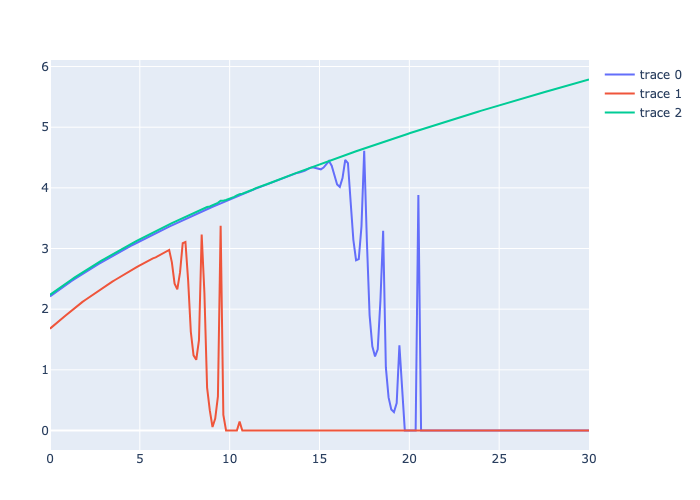

In [128]:
op_plot = scatter(x=Deltas,y=expval)
op_plot_p = scatter(x=Deltas,y=expval_p)
op_plot_m = scatter(x=Deltas,y=expval_m)

layout = Layout(
    yaxis_title="<a^{dagger}a>",
    xaxis_title="Δ",
    width=500,
    height=500,
)


plot([op_plot,op_plot_p, op_plot_m])

Looks very similar, with a slight curve. Shouldn't be surprising because $n$ can be thought of as $\alpha^2$. This is just the square root of the plot above, and signifies that, at the transition, the steady state goes from being a superposition of the logical states (with $\alpha \neq 0 $) to being the vacuum state ()

# Transition rate $\Gamma$ in parameter space

## $\Gamma$ vs. $|\alpha|^2$, $\kappa_{1}$

In [2]:
# set the parameters for this section
N = 90
Δ = 0.
G = 5.
tg = 1e-2
κ1 = 1e-3
κϕ = 1e-5
nev = 4
sigma = 1e-7

# make a list of Gs 
res = 20
Gs = range(2,5,length=res)
κ1s = exp10.(range(-8,-2,length=res))
Δs = range(0,50,length=res)

# make a return array
rates = zeros(ComplexF64, length(Gs))

# for a given G, compute Γ
function get_lowest_rate(N::Int, Δ::Real, G::Real, tg::Real, κ1::Real, κϕ::Real, nev::Int, sigma::Real)
    L = get_liouvillian(N, Δ, G, tg, κ1, κϕ)[1]
    rates, ρs = get_lowlying(N, G, Δ, tg, κ1, κϕ, nev, sigma)
    return rates[2][1]
end;


In [5]:
# loop over Gs broadcasting the function
Γs_G = map(G-> -real(get_lowest_rate(N, Δ, G, tg, κ1, κϕ, nev, sigma)), Gs);
Γs_κ1 = map(κ1-> -real(get_lowest_rate(N, Δ, G, tg, κ1, κϕ, nev, sigma)), κ1s);
Γs_Δ = map(Δ-> -real(get_lowest_rate(N, Δ, G, tg, κ1, κϕ, nev, sigma)), Δs);


┌ Warning: attempting to remove probably stale pidfile
│   path = /Users/leo/.jlassetregistry.lock
└ @ Pidfile /Users/leo/.julia/packages/Pidfile/DDu3M/src/Pidfile.jl:260


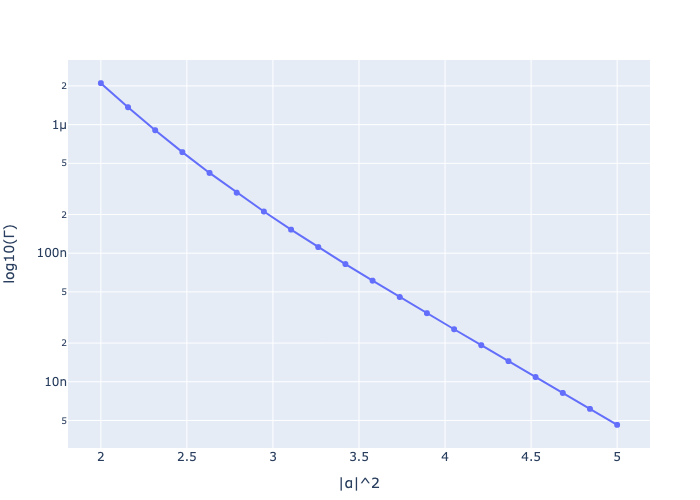

In [6]:
# plot the results
scatter_plot = scatter(x=Gs, y=Γs_G, mode="lines+markers")

layout = Layout(
    yaxis_title="log10(Γ)",
    xaxis_title="|α|^2",
    yaxis_type="log",
    width=500,
    height=500
)

plot(scatter_plot, layout)

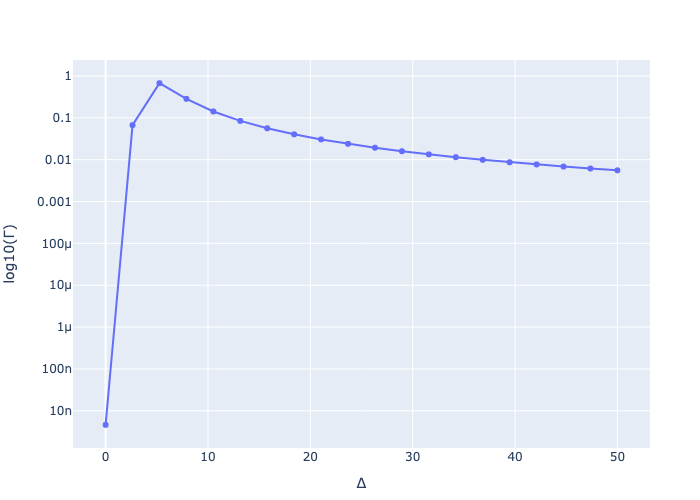

In [82]:
# plot the results
scatter_plot = scatter(x=Δs, y=Γs_Δ, mode="lines+markers")

layout = Layout(
    yaxis_title="log10(Γ)",
    xaxis_title="Δ",
    yaxis_type="log",
    width=500,
    height=500
)

plot(scatter_plot, layout)

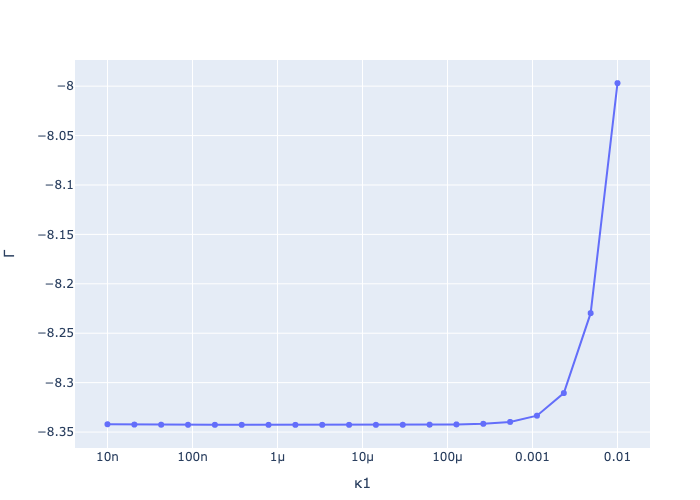

In [80]:
# plot the results
scatter_plot = scatter(x=(κ1s), y=log10.(abs.(Γs_κ1)), mode="lines+markers")

layout = Layout(
    yaxis_title="Γ",
    xaxis_title="κ1",
    xaxis_type="log",
    width=500,
    height=500
)

plot(scatter_plot, layout)

$\Gamma$ decreases with increasing mean photon number $|\alpha|^2 ~ G$ and increases with the rate of single photon loss. This makes sense. Indeed, a larger $\kappa_1$ signifies more single photon loss and the associated transfer matrix elements for both bit-flips and phase-flips will increase (albeit linearly) with $\kappa_1$.

**Problem:** rate should be linear in $\kappa_1$, and indeed I don't see why it isn't. But for $\kappa_{\phi} = 0$ it is, though with values much smaller than expected (flirting with the $10^{-15}$). 

Intuitively, the steady state is $\rho_{ss} = |\alpha\rangle\langle\alpha| + |-\alpha\rangle\langle-\alpha|$ while the lowest-lying off-diagonal is $\rho_{0}^{-} = |\alpha\rangle\langle\alpha| - |-\alpha\rangle\langle-\alpha|$. The rate $\Gamma = -\mathrm{Re}\left(\Lambda_{0}^{-}\right)$ is how fast the state decays into the steady state, and therefore how fast $|\alpha\rangle\langle\alpha| \to |-\alpha\rangle\langle-\alpha|$ and vice-versa. In other words, it is the bit-flip rate.

## $\Gamma$ vs. $U/\eta$, $\Delta$

In [7]:
# calculate the rate of the lowest-lying off-diagonal for various values of Δ, U/η

# set the parameters for this section
N = 90
G = 5.
κ1 = 1e-3
κϕ = 1e-5
nev = 4
sigma = 1e-7

# for a given value of Δ, U/η, calculate the rate of the lowest-lying off-diagonal

# get lowest-lying off-diagonal
function get_lowest_rate_tuples(params::Tuple{Real, Real})
    Δ, tg = params
    L = get_liouvillian(N, Δ, G, tg, κ1, κϕ)[1]
    rates, ρs = get_lowlying(N, G, Δ, tg, κ1, κϕ, nev, sigma)
    return rates[2][1]
end

res = 20
tg_values = 10 .^range(-2, 6, length=res)
Δ_values = range(0, 50, length=res)

# make list of tg and delta tuples
params = Iterators.product(Δ_values, tg_values);


In [8]:
Γs = -real(get_lowest_rate_tuples.(params)) # very long for res = 20

20×20 Matrix{Float64}:
 4.62219e-9  4.63372e-9  4.7125e-9   …  4.99917e-5  4.99923e-5  4.99925e-5
 0.0668605   0.0639021   0.0563827      8.40888e-6  8.88066e-6  9.07931e-6
 0.672853    0.689106    0.735186       7.55703e-7  8.69785e-7  9.23617e-7
 0.284209    0.288413    0.299776       1.50532e-7  1.85763e-7  2.03762e-7
 0.141587    0.142887    0.146259       8.20683e-8  1.04248e-7  1.16508e-7
 0.0843172   0.0848525   0.0861888   …  2.74278e-8  3.71298e-8  4.29073e-8
 0.0562227   0.0564917   0.0571409      1.67967e-8  2.30118e-8  2.69717e-8
 0.0403474   0.0405015   0.0408613      1.23025e-8  1.70725e-8  2.03235e-8
 0.0304713   0.0305677   0.0307858      3.78854e-9  5.55726e-9  6.84469e-9
 0.0238929   0.0239572   0.0240979      6.0907e-9   8.70747e-9  1.06813e-8
 0.0192826   0.0193276   0.0194228   …  4.89664e-9  6.90238e-9  8.48783e-9
 0.0159222   0.0159549   0.0160216      1.86561e-9  2.71407e-9  3.43419e-9
 0.0133951   0.0134195   0.0134676      3.39964e-9  4.80598e-9  6.03057e-9
 0

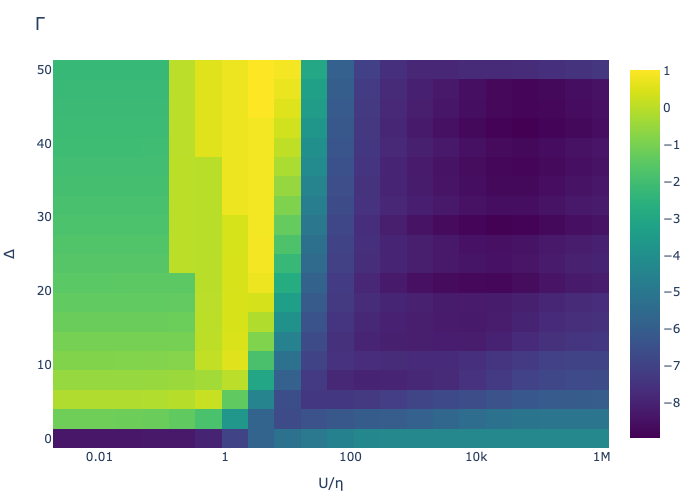

In [ ]:
heatmap_trace = heatmap(x=tg_values, y=Δ_values, z=log10.(Γs), colorscale="Viridis")
# Define the layout
layout = Layout(
    title="Γ",
    xaxis_title="U/η",
    yaxis_title="Δ",
    xaxis_type="log",
)

# Create the plot
plot(heatmap_trace, layout)

This looks good, just need higher resolution and a better colorscale.

In [5]:
params_collect = collect(params);

In [10]:
Threads.nthreads()

6

In [9]:
using Base.Threads

res = Array{Float64}(undef, size(params))

Threads.@threads for i in 1:length(params_collect)
    # println(params_collect[i])
    res[i] = -real(get_lowest_rate_tuples(params_collect[i]))
end

┌ Error: XYAUPD_Exception: No shifts could be applied during a cycle of the Implicitly restarted Arnoldi iteration. One possibility is to increase the size of NCV relative to NEV. 
│   info = 3
└ @ Arpack /Users/leo/.julia/packages/Arpack/FCvNd/src/libarpack.jl:47


CompositeException: TaskFailedException

    nested task error: 
    Stacktrace:
      [1] aupd_wrapper(T::Type, matvecA!::Arpack.var"#12#22"{SparseMatrixCSC{ComplexF64, Int64}}, matvecB::Arpack.var"#13#23", solveSI::Arpack.var"#15#25", n::Int64, sym::Bool, cmplx::Bool, bmat::String, nev::Int64, ncv::Int64, which::String, tol::Float64, maxiter::Int64, mode::Int64, v0::Vector{ComplexF64}, check::Int64)
        @ Arpack ~/.julia/packages/Arpack/FCvNd/src/libarpack.jl:141
      [2] _eigs(A::SparseMatrixCSC{ComplexF64, Int64}, B::UniformScaling{Bool}; nev::Int64, ncv::Int64, which::Symbol, tol::Float64, maxiter::Int64, sigma::Float64, v0::Vector{ComplexF64}, ritzvec::Bool, explicittransform::Symbol, check::Int64)
        @ Arpack ~/.julia/packages/Arpack/FCvNd/src/Arpack.jl:240
      [3] _eigs
        @ ~/.julia/packages/Arpack/FCvNd/src/Arpack.jl:75 [inlined]
      [4] eigs
        @ ~/.julia/packages/Arpack/FCvNd/src/Arpack.jl:51 [inlined]
      [5] eigs
        @ ~/.julia/packages/Arpack/FCvNd/src/Arpack.jl:50 [inlined]
      [6] get_lowlying(N::Int64, G::Float64, Delta::Float64, tg::Float64, k1::Float64, kphi::Float64, nev::Int64, sigma::Float64; nvecs::Int64, left::Bool, maxiter::Int64)
        @ Main ~/Desktop/PhD research/Code and notebooks/simple_phd_codes/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_W3sZmlsZQ==.jl:106
      [7] get_lowlying(N::Int64, G::Float64, Delta::Float64, tg::Float64, k1::Float64, kphi::Float64, nev::Int64, sigma::Float64)
        @ Main ~/Desktop/PhD research/Code and notebooks/simple_phd_codes/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_W3sZmlsZQ==.jl:85
      [8] get_lowest_rate_tuples(params::Tuple{Float64, Float64})
        @ Main ~/Desktop/PhD research/Code and notebooks/simple_phd_codes/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_Y120sZmlsZQ==.jl:18
      [9] macro expansion
        @ ~/Desktop/PhD research/Code and notebooks/simple_phd_codes/jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_Y131sZmlsZQ==.jl:7 [inlined]
     [10] (::var"#133#threadsfor_fun#34"{var"#133#threadsfor_fun#33#35"{UnitRange{Int64}}})(tid::Int64; onethread::Bool)
        @ Main ./threadingconstructs.jl:215
     [11] #133#threadsfor_fun
        @ ./threadingconstructs.jl:182 [inlined]
     [12] (::Base.Threads.var"#1#2"{var"#133#threadsfor_fun#34"{var"#133#threadsfor_fun#33#35"{UnitRange{Int64}}}, Int64})()
        @ Base.Threads ./threadingconstructs.jl:154

...and 4 more exceptions.


# Bias-preserving gates

In [65]:
# set the parameters for this section
N = 40
Δ = 0.
G = 5
tg = 1e5*0
k1 = 1e-5
kphi = 1e-3

a = destroy(N)
ad = create(N);

In [38]:
# define the parity super operator
parity = expm(1im*pi*ad*a);
parity_super = sprepost(parity,parity'); # superoperator

Quantum Object:   type=SuperOperator   dims=[40]   size=(1600, 1600)
1600×1600 SparseMatrixCSC{ComplexF64, Int64} with 1600 stored entries:
⎡⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎤
⎢⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⎥
⎣⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⎦

In [97]:
# check: positive parity should become negative parity after one cycle, t = T = pi/4FRe(α)

# after a time T = pi / 4FRe(α), the cat state should have rotated to the negative parity cat state
α = sqrt(G)
ρ0 = normalize(coherent(N,α)+coherent(N,-α))
F = 0.1
Hdrive = F*(ad+a)
T = pi / (4 * F * real(α))
tlist = range(0, T, length=1000)
# liouvillian is simple cat liouvillian
result = mesolve(liouvillian(Hdrive,[a^2-α^2*qeye(N)]), ρ0, tlist, [], e_ops=[parity])
expectation_values = real(result.expect);


Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)


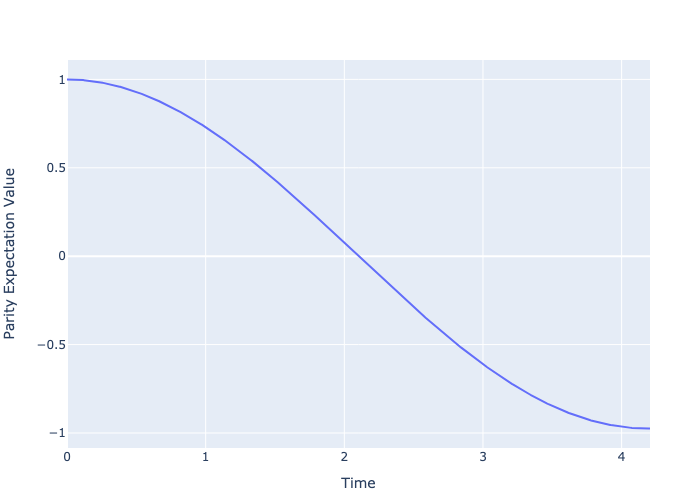

In [98]:
plot_trace = scatter(x=collect(tlist), y=expectation_values[1,:], mode="lines")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Parity Expectation Value"
)

plot(plot_trace, layout)

In [94]:
# calculate error probability
pz_basic = (expectation_values[end] + 1)/2 # i'm surprised it's this high

0.012414457725599126

This reaches $-1$ at the desired time $T$.

Now for the full $\mathcal{L}$:

In [116]:
# now, use full liouvillian
N = 40
Δ = 0.
G = 5
tg = 1e5*0
k1 = 1e-5
kphi = 1e-3

# be careful with alpha, it is not necessarily the same as before
α = sqrt(1im*G)
ρ0 = normalize(coherent(N,α)+coherent(N,-α))
F = 0.1
Hdrive = F*(ad+a)
T = pi / (4 * F * real(α))
tlist = range(0, T, length=1000)
# liouvillian is full liouvillian
L = get_liouvillian(N, Δ, G, tg, k1, kphi)[1] + liouvillian(Hdrive)
result = mesolve(L, ρ0, tlist, [], e_ops=[parity])
expectation_values = real(result.expect);

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)


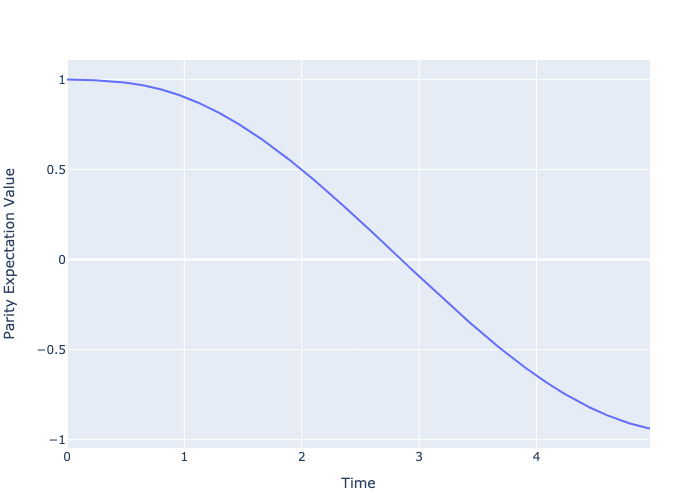

In [117]:
plot_trace = scatter(x=collect(tlist), y=expectation_values[1,:], mode="lines")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Parity Expectation Value"
)

plot(plot_trace, layout)

In [110]:
# calculate error probability
pz_full = (expectation_values[end] + 1)/2

0.030667952733481108

We see that it does not reach $-1$ for the expected time due to the errors. Note that we have to make $\alpha^2 = iG$ because this is prescribed by the fact that $G$ is real.

Now we will loop over different values of $T$ and allow for $\alpha$ (and consequently, $G$) to vary.

In [118]:
# loop over different T values
T_values = range(0.1, 5, length=100)
pz_values = zeros(length(T_values)) # the value of the parity at the end of the run

for (i, T) in enumerate(T_values)
    # set alpha and calculate G
    G = 2 * pi^2 / (4*F*T)^2
    α = sqrt(1im*G)
    # calculate Liouvillian
    L = get_liouvillian(N, Δ, G, tg, k1, kphi)[1] + liouvillian(Hdrive)
    ρ0 = normalize(coherent(N, α) + coherent(N, -α)) # not a density matrix but mesolve does not care
    result = mesolve(L, ρ0, collect(range(0,T, length=100)), [], e_ops=[parity]);
    parity_expect = real(result.expect)
    pz_values[i] = parity_expect[end]
end

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 04s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [===================

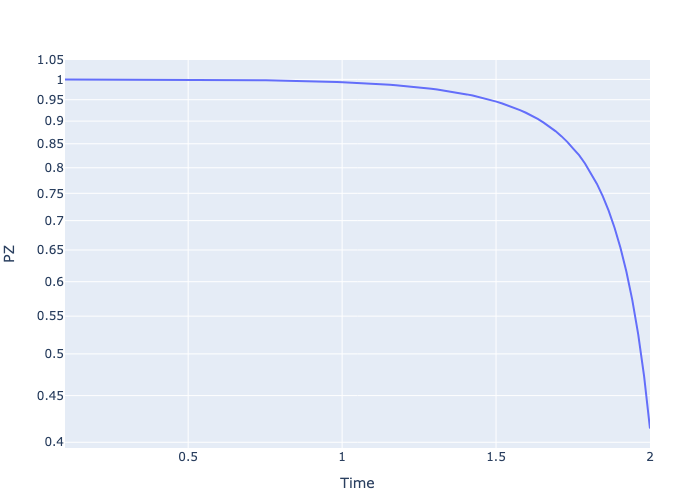

In [113]:
plot_trace = scatter(x=T_values, y=pz_values, mode="lines")

# make y axis log scale
layout = Layout(
    yaxis_type="log",
    yaxis_title="PZ",
    xaxis_title="Time"
)

plot(plot_trace, layout)